In [1]:
##################
# Imports

# general package imports
import os
import sys
import numpy as np
import math
import cv2
import matplotlib.pyplot as plt
import copy
import zlib
from easydict import EasyDict as edict

# Add current working directory to path
sys.path.append(os.getcwd())

# Waymo open dataset reader
from tools.waymo_reader.simple_waymo_open_dataset_reader import WaymoDataFileReader, dataset_pb2, label_pb2
from tools.waymo_reader.simple_waymo_open_dataset_reader import utils as waymo_utils

# misc. project-related imports
import misc.objdet_tools as tools
from misc.helpers import load_object_from_file

# add exercise directories to python path to enable relative imports
# SCRIPT_DIR = os.path.dirname(os.path.realpath(os.path.join(os.getcwd(), os.path.expanduser(__file__))))
SCRIPT_DIR ='/home/workspace/'

EXE_L1 = 'lesson-1-lidar-sensor/exercises/starter'
EXA_L1 = 'lesson-1-lidar-sensor/examples'
EXE_L2 = 'lesson-2-object-detection/exercises/starter'
EXA_L2 = 'lesson-2-object-detection/examples'
sys.path.append(os.path.normpath(os.path.join(SCRIPT_DIR, EXE_L1)))
sys.path.append(os.path.normpath(os.path.join(SCRIPT_DIR, EXA_L1)))
sys.path.append(os.path.normpath(os.path.join(SCRIPT_DIR, EXE_L2)))
sys.path.append(os.path.normpath(os.path.join(SCRIPT_DIR, EXA_L2)))

# import functions from individual exercise files
import l2_examples
import l2_exercises
import l1_examples
import l1_exercises


##################
# Set parameters and perform initializations

# Select Waymo Open Dataset file and frame numbers
data_filename = 'training_segment-1005081002024129653_5313_150_5333_150_with_camera_labels.tfrecord' # Sequence 1
#data_filename = 'training_segment-10072231702153043603_5725_000_5745_000_with_camera_labels.tfrecord' # Sequence 2
# data_filename = 'training_segment-10963653239323173269_1924_000_1944_000_with_camera_labels.tfrecord'  # Sequence 3
show_only_frames = [0, 10]  # show only frames in interval for debugging

# set pause time between frames in ms (0 = stop between frames until key is pressed)
vis_pause_time = 0  

# Prepare Waymo Open Dataset file for loading
data_fullpath = os.path.join(SCRIPT_DIR, 'dataset', data_filename)  # adjustable path in case this script is called from another working directory
results_fullpath = os.path.join(SCRIPT_DIR, 'results')
datafile = WaymoDataFileReader(data_fullpath)
datafile_iter = iter(datafile)  # initialize dataset iterator

# get one frame
frame = next(datafile_iter)


In [5]:
datafile_iter

In [6]:
frame

context {
  name: "1005081002024129653_5313_150_5333_150"
  camera_calibrations {
    name: FRONT
    intrinsic: 2083.091212133254
    intrinsic: 2083.091212133254
    intrinsic: 957.2938286685071
    intrinsic: 650.5697927719348
    intrinsic: 0.04067236637270731
    intrinsic: -0.3374271466716414
    intrinsic: 0.0016273829099200004
    intrinsic: -0.0007879327563938157
    intrinsic: 0.0
    extrinsic {
      transform: 0.9999151800844592
      transform: -0.008280529275085654
      transform: -0.010053132426658727
      transform: 1.5444145042510942
      transform: 0.008380895965622895
      transform: 0.9999150476776223
      transform: 0.009982885888937929
      transform: -0.022877347388980857
      transform: 0.009969614810858722
      transform: -0.010066293398396434
      transform: 0.9998996332221252
      transform: 2.115953541712884
      transform: 0.0
      transform: 0.0
      transform: 0.0
      transform: 1.0
    }
    width: 1920
    height: 1280
    rolling_shutte

In [7]:
type(frame)

simple_waymo_open_dataset_reader.dataset_pb2.Frame

# Exercise C1-3-1 print no. of vehicles

In [10]:
frame.lasers

[name: TOP
ri_return1 {
  range_image_compressed: "x^\354\375\007\224UE\263.\000|\212\204!L`\030\006D\030r\220(9\3149sv\343\020%\243d\006\034r\032\020P\014\310\020\207\234\223 IP\202 9\207\221 H\316\242\344\034D\tJ\220 \274\265\252v\325>\373\334\377\277\377[\353\275\365\356\377\356\235Y\353\2545\265\252\273\272\272\272\272\272\253\272zw\372\304#_\277\002$&\247\374R~)\277\224_\312\357\337\3777\266\2311@\t\017\350\357?/\233\202K\301\245\340Rp\377\'\270\014}&\032 \265\027\266\2759\365\305$\003\314\364&\377\322\304\003$&\357\273:\311\000\243\275qWgz\376\021\255\317fM1\300Y\265Wk\342&\033`\2417\346r!\252\277\255\310d\003\374\352\035\367Sg/\220\230|\251\315$\003\334\364\016\270>\216\3607\243\'\031\340\221\266\177!a\222\001\352*\374\257~\243jN1\300Zo\324\305\325D\377j\203I\006h\353}y.\206\350\037:0\311\000\355\274/\317\305\020~c\365\311\006\250\354\215\271\274\220\360;\262L6@\256\377\355\366R\340\177oxs\376>\006\270\241\372X\346tW\003d\366&\\\233B\343\037\177\240\213\001\032{_\236K\246\361\03

In [13]:
len(frame.lasers)

5

In [12]:
frame.lasers[0].name

1

In [14]:
frame.laser_labels

[box {
  center_x: -20.020040598094056
  center_y: 7.255771617461505
  center_z: 0.5024888653456401
  width: 1.9828961125840503
  length: 4.760235235989989
  height: 1.6800000000000068
  heading: -0.009081201874720168
}
metadata {
  speed_x: 20.330629091724095
  speed_y: 0.2304147476950128
  accel_x: 0.22777614739139299
  accel_y: 0.03386023019193613
}
type: TYPE_VEHICLE
id: "8EFRSwEXBf9P-SzIDRzx0A"
, box {
  center_x: 50.41102899917314
  center_y: 3.7574178158320137
  center_z: 0.9634878537108307
  width: 2.0181655979297246
  length: 4.513134775681905
  height: 1.7700000000000102
  heading: -0.005225447353401691
}
metadata {
  speed_x: 17.879238051739502
  speed_y: 0.2714639645808662
  accel_x: -0.11760476277109007
  accel_y: 0.009923281494627609
}
type: TYPE_VEHICLE
id: "VJ3F-NiHmRQh0umylCVJmA"
, box {
  center_x: -41.594662070308914
  center_y: 25.978025256679757
  center_z: 3.055462171344061
  width: 0.6350746870643111
  length: 0.09090727433218965
  height: 1.1099999999999852
  he

In [7]:
type(frame.laser_labels), len(frame.laser_labels), type(frame.laser_labels[0])

(google.protobuf.pyext._message.RepeatedCompositeContainer,
 12,
 simple_waymo_open_dataset_reader.label_pb2.Label)

In [3]:
frame.laser_labels[0]

box {
  center_x: -20.020040598094056
  center_y: 7.255771617461505
  center_z: 0.5024888653456401
  width: 1.9828961125840503
  length: 4.760235235989989
  height: 1.6800000000000068
  heading: -0.009081201874720168
}
metadata {
  speed_x: 20.330629091724095
  speed_y: 0.2304147476950128
  accel_x: 0.22777614739139299
  accel_y: 0.03386023019193613
}
type: TYPE_VEHICLE
id: "8EFRSwEXBf9P-SzIDRzx0A"

In [2]:
frame.laser_labels[0].type

1

In [5]:
frame.laser_labels[0].Type

In [6]:
frame.laser_labels[0].Type.TYPE_VEHICLE

1

In [4]:
frame.laser_labels[0].TYPE_VEHICLE

1

In [8]:
count = 0
for label in frame.laser_labels:
    print(label.type, label.TYPE_VEHICLE)
    
    if label.type == label.TYPE_VEHICLE:
        count += 1
        
print(count)

1 1
1 1
3 1
3 1
1 1
1 1
1 1
3 1
3 1
3 1
1 1
3 1
6


# Example C1-3-2 display camera image

In [2]:
from PIL import Image
import io
import sys
import os
import cv2
import open3d as o3d
import math
import numpy as np
import zlib
from sklearn.preprocessing import RobustScaler, StandardScaler, QuantileTransformer

## Add current working directory to path
sys.path.append(os.getcwd())

## Waymo open dataset reader
from tools.waymo_reader.simple_waymo_open_dataset_reader import dataset_pb2

In [2]:
len(frame.images), type(frame.images), type(frame.images[0])

(5,
 google.protobuf.pyext._message.RepeatedCompositeContainer,
 simple_waymo_open_dataset_reader.dataset_pb2.CameraImage)

In [3]:
camera_image = frame.images[0]
camera_image

name: FRONT
image: "\377\330\377\340\000\020JFIF\000\001\001\000\000\001\000\001\000\000\377\333\000\204\000\003\002\002\003\002\002\003\003\003\003\004\003\003\004\005\010\005\005\004\004\005\n\007\007\006\010\014\n\014\014\013\n\013\013\r\016\022\020\r\016\021\016\013\013\020\026\020\021\023\024\025\025\025\014\017\027\030\026\024\030\022\024\025\024\001\003\004\004\005\004\005\t\005\005\t\024\r\013\r\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\024\377\300\000\021\010\005\000\007\200\003\001\"\000\002\021\001\003\021\001\377\304\000\035\000\000\001\005\001\001\001\001\000\000\000\000\000\000\000\000\000\002\000\001\003\004\005\006\007\010\t\377\304\000M\020\000\001\003\003\003\002\004\005\002\005\002\004\004\003\002\017\001\002\003\021\000\004!\005\0221AQ\006\023\"a\007\0242q\201B\221\025#R\241\261\010\301\0263b\321$r\341\360\0274C\20

In [6]:
camera_image.name

1

In [10]:
camera_image.CameraName

AttributeError: CameraName

In [11]:
camera_image.CameraName.Name

AttributeError: CameraName

In [12]:
dataset_pb2.CameraName.FRONT

1

In [17]:
type(camera_image.image), len(camera_image.image)

(bytes, 378453)

In [14]:
camera_image.image

b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00\x01\x00\x00\xff\xdb\x00\x84\x00\x03\x02\x02\x03\x02\x02\x03\x03\x03\x03\x04\x03\x03\x04\x05\x08\x05\x05\x04\x04\x05\n\x07\x07\x06\x08\x0c\n\x0c\x0c\x0b\n\x0b\x0b\r\x0e\x12\x10\r\x0e\x11\x0e\x0b\x0b\x10\x16\x10\x11\x13\x14\x15\x15\x15\x0c\x0f\x17\x18\x16\x14\x18\x12\x14\x15\x14\x01\x03\x04\x04\x05\x04\x05\t\x05\x05\t\x14\r\x0b\r\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\x14\xff\xc0\x00\x11\x08\x05\x00\x07\x80\x03\x01"\x00\x02\x11\x01\x03\x11\x01\xff\xc4\x00\x1d\x00\x00\x01\x05\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x02\x00\x01\x03\x04\x05\x06\x07\x08\t\xff\xc4\x00M\x10\x00\x01\x03\x03\x03\x02\x04\x05\x02\x05\x02\x04\x04\x03\x02\x0f\x01\x02\x03\x11\x00\x04!\x05\x121AQ\x06\x13"a\x07\x142q\x81B\x91\x15#R\xa1\xb1\x08\xc1\x163b\xd1$r\xe1\xf0\x174C\x82\xf1%5Sc\x92\x18&s\

In [20]:
io.BytesIO(camera_image.image)

In [4]:
image_obj = Image.open(io.BytesIO(camera_image.image))
type(image_obj)

PIL.JpegImagePlugin.JpegImageFile

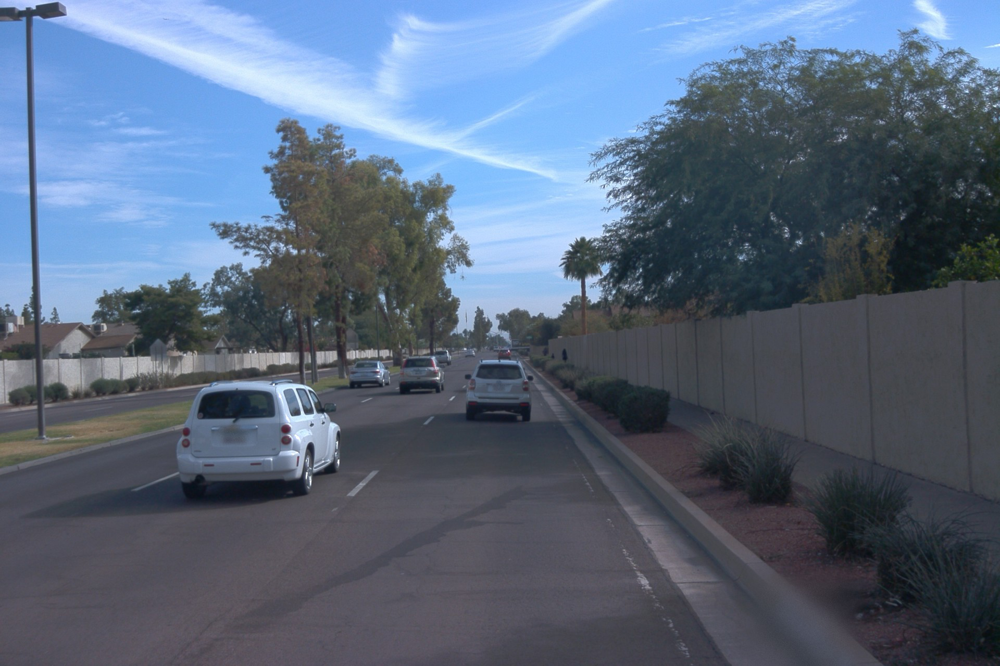

In [26]:
image_obj

In [28]:
np.array(image_obj)

array([[[160, 182, 239],
        [160, 182, 239],
        [163, 185, 242],
        ...,
        [119, 175, 249],
        [119, 175, 249],
        [120, 176, 251]],

       [[161, 184, 238],
        [162, 185, 239],
        [164, 187, 241],
        ...,
        [119, 175, 249],
        [118, 174, 248],
        [118, 174, 248]],

       [[160, 185, 239],
        [162, 187, 241],
        [162, 187, 241],
        ...,
        [121, 177, 251],
        [120, 176, 250],
        [119, 175, 249]],

       ...,

       [[ 72,  72,  82],
        [ 73,  73,  83],
        [ 74,  74,  84],
        ...,
        [ 24,  32,  35],
        [ 23,  32,  37],
        [ 25,  34,  41]],

       [[ 71,  71,  83],
        [ 72,  72,  84],
        [ 73,  73,  85],
        ...,
        [ 24,  31,  37],
        [ 22,  33,  39],
        [ 23,  33,  42]],

       [[ 70,  72,  84],
        [ 72,  72,  84],
        [ 73,  73,  85],
        ...,
        [ 22,  31,  36],
        [ 20,  31,  37],
        [ 18,  31,  39]]

In [5]:
img = cv2.cvtColor( np.array(image_obj), cv2.COLOR_BGR2RGB)
type(img), img.shape

(numpy.ndarray, (1280, 1920, 3))

In [30]:
img

array([[[239, 182, 160],
        [239, 182, 160],
        [242, 185, 163],
        ...,
        [249, 175, 119],
        [249, 175, 119],
        [251, 176, 120]],

       [[238, 184, 161],
        [239, 185, 162],
        [241, 187, 164],
        ...,
        [249, 175, 119],
        [248, 174, 118],
        [248, 174, 118]],

       [[239, 185, 160],
        [241, 187, 162],
        [241, 187, 162],
        ...,
        [251, 177, 121],
        [250, 176, 120],
        [249, 175, 119]],

       ...,

       [[ 82,  72,  72],
        [ 83,  73,  73],
        [ 84,  74,  74],
        ...,
        [ 35,  32,  24],
        [ 37,  32,  23],
        [ 41,  34,  25]],

       [[ 83,  71,  71],
        [ 84,  72,  72],
        [ 85,  73,  73],
        ...,
        [ 37,  31,  24],
        [ 39,  33,  22],
        [ 42,  33,  23]],

       [[ 84,  72,  70],
        [ 84,  72,  72],
        [ 85,  73,  73],
        ...,
        [ 36,  31,  22],
        [ 37,  31,  20],
        [ 39,  31,  18]]

In [6]:
dim = ( int(img.shape[1] * 0.5), int(img.shape[0] * 0.5) )
dim

(960, 640)

In [7]:
resized_img = cv2.resize(img, dim)
type(resized_img), resized_img.shape

(numpy.ndarray, (640, 960, 3))

In [8]:
resized_img

array([[[239, 183, 161],
        [243, 187, 165],
        [242, 186, 164],
        ...,
        [247, 177, 120],
        [248, 176, 119],
        [249, 175, 119]],

       [[239, 185, 160],
        [239, 185, 160],
        [239, 185, 161],
        ...,
        [247, 177, 120],
        [251, 179, 122],
        [250, 176, 120]],

       [[239, 184, 158],
        [239, 185, 159],
        [240, 185, 160],
        ...,
        [249, 178, 121],
        [251, 180, 123],
        [250, 177, 121]],

       ...,

       [[ 82,  73,  74],
        [ 85,  74,  76],
        [ 86,  75,  77],
        ...,
        [ 34,  35,  31],
        [ 35,  33,  29],
        [ 34,  30,  26]],

       [[ 83,  73,  73],
        [ 85,  75,  75],
        [ 85,  74,  75],
        ...,
        [ 36,  34,  33],
        [ 35,  32,  26],
        [ 38,  32,  24]],

       [[ 84,  72,  71],
        [ 85,  73,  73],
        [ 84,  74,  74],
        ...,
        [ 36,  32,  33],
        [ 36,  32,  25],
        [ 39,  32,  21]]

In [9]:
# cause crush
# cv2.imshow('FROINT', resized_img)

# Example C1-3-3: print angle of vertical field of view 

In [2]:
from PIL import Image
import io
import sys
import os
import cv2
import open3d as o3d
import math
import numpy as np
import zlib
from sklearn.preprocessing import RobustScaler, StandardScaler, QuantileTransformer

## Add current working directory to path
sys.path.append(os.getcwd())

## Waymo open dataset reader
from tools.waymo_reader.simple_waymo_open_dataset_reader import dataset_pb2

In [4]:
lidar_cali = [obj for obj in frame.context.laser_calibrations if obj.name == dataset_pb2.LaserName.TOP][0]
lidar_cali

name: TOP
beam_inclinations: -0.3068221643606317
beam_inclinations: -0.29616997127840206
beam_inclinations: -0.2853962204525353
beam_inclinations: -0.2746601303299283
beam_inclinations: -0.2644333813317894
beam_inclinations: -0.2547203518161254
beam_inclinations: -0.2451132959715716
beam_inclinations: -0.23558114040681422
beam_inclinations: -0.22619708514421144
beam_inclinations: -0.21731641865081186
beam_inclinations: -0.20758272607836958
beam_inclinations: -0.19887296032455892
beam_inclinations: -0.19035328460083245
beam_inclinations: -0.18198429312782394
beam_inclinations: -0.1736864756471841
beam_inclinations: -0.16585362025780892
beam_inclinations: -0.15781802751504315
beam_inclinations: -0.15015955231667588
beam_inclinations: -0.14255145051670604
beam_inclinations: -0.135341813293673
beam_inclinations: -0.12822897363273378
beam_inclinations: -0.12122709544366828
beam_inclinations: -0.11464284303455963
beam_inclinations: -0.10786407088929861
beam_inclinations: -0.10122563229416759

In [7]:
vfov_rad = lidar_cali.beam_inclination_max - lidar_cali.beam_inclination_min
vfov_rad

0.35535292290893705

In [9]:
vfov_degree = vfov_rad / np.pi * 180
vfov_degree

20.360222720319797

In [11]:
len(lidar_cali.beam_inclinations)

64

In [12]:
lidar_cali.extrinsic

transform: -0.8526719509207284
transform: -0.5224378704141576
transform: -0.0030357322277815815
transform: 1.43
transform: 0.5224451202853144
transform: -0.8526692389088371
transform: -0.0025030598650299957
transform: 0.0
transform: -0.0012807822227881296
transform: -0.0037202924272838555
transform: 0.9999922594806188
transform: 2.184
transform: 0.0
transform: 0.0
transform: 0.0
transform: 1.0